<a href="https://colab.research.google.com/github/NBO2001/DigitalDesafios/blob/main/classifica_faces_task.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
import cv2
import numpy as np
import gdown
import os
import tensorflow as tf
from tensorflow import keras
from tensorflow.keras.utils import to_categorical
from sklearn.utils import shuffle
import matplotlib.pyplot as plt
import random
from sklearn.model_selection import KFold
from IPython import display
from tensorflow.keras.callbacks import ModelCheckpoint
from tensorflow.keras.preprocessing.image import ImageDataGenerator
import subprocess
from tensorflow.keras.models import load_model
from google.colab import files

# Alerta

A célula a seguir irá treinar o modelo para reconhecer a face de amigos e familiares, devido a isso, o dataset utilizado não pode ser compartilhado.

In [4]:
def load_dataset(path, labels):

  x_train = list()
  y_train = list()

  for label in labels:

    path_imgs = os.path.join(path,label)
    all_files = os.listdir(path_imgs)

    for photo in all_files:

      img = cv2.imread(os.path.join(path_imgs,photo))

      x_train.append(img)
      y_train.append(labels[label])

  x_train = np.array(x_train)
  y_train = np.array(y_train)

  x_train = x_train.astype('float32')/255.0
  y_train = to_categorical(y_train)

  x_train, y_train = shuffle(x_train, y_train, random_state=42)

  return x_train, y_train

def plot_image(img, label="Exemplo"):
  int_image = (img * 255.0).astype(np.uint8)

  plt.imshow(int_image)
  plt.title(label)
  plt.axis('off')
  plt.show()
  plt.close()

def create_datagen():
    datagen = ImageDataGenerator(
        rotation_range=20,         # rotação aleatória de imagens no intervalo (graus, 0 a 180)
        shear_range=0.2,           # aplicar cisalhamento aleatório
        horizontal_flip=True,      # inverter aleatoriamente as imagens horizontalmente
        fill_mode='nearest'        # estratégia usada para preencher pixels recém-criados
    )
    return datagen

def create_model():

  model = keras.Sequential()

  model.add(
      keras.layers.Conv2D(filters=64, kernel_size=(2,2), strides=(2,2), padding='same', input_shape=(256,256,3))
  )
  model.add( keras.layers.BatchNormalization() )
  model.add( keras.layers.LeakyReLU() )

  model.add( keras.layers.Dropout(rate=0.2))

  model.add(
      keras.layers.Conv2D(filters=128, kernel_size=(2,2), strides=(2,2), padding='same')
  )
  model.add( keras.layers.BatchNormalization() )
  model.add( keras.layers.LeakyReLU() )

  model.add(
      keras.layers.Flatten()
  )

  model.add(
      keras.layers.Dense(units=200, activation='relu')
  )

  model.add(
      keras.layers.Dense(units=8, activation='softmax')
  )

  return model

all_arq = os.listdir("./")

if not ('faces_dataset' in all_arq):
  pass

labels = {
    'girlana':0,
    'mikaelly':1,
    'person':2,
    'rosilene':3,
    'beatriz':4,
    'eduarda':5,
    'natan':6,
    'thais':7
}

label_map = {v: k for k, v in labels.items()}

x_train, y_train = load_dataset('./faces_dataset', labels)

# Criar o gerador de dados (data generator)
datagen = create_datagen()

def evaluation_model(x_train, y_train, n_folds=5):
    scores, histories = list(), list()

    # Criar o diretório onde os modelos serão salvos, se ainda não existir
    os.makedirs('best_models', exist_ok=True)

    # Melhor acurácia e modelo correspondente
    best_acc = 0.0
    best_model = None

    folds = KFold(n_folds, shuffle=True, random_state=15)
    c = 1

    for train_ix, test_ix in folds.split(x_train):

        print(f"Fold {c}")

        # Inicializar o modelo
        my_model = create_model()
        opt = keras.optimizers.SGD(learning_rate=0.001)
        my_model.compile(optimizer=opt, loss='categorical_crossentropy', metrics=['accuracy'])

        # Dados de treinamento e teste
        X_data_train, Y_data_train, X_data_test, Y_data_test = x_train[train_ix], y_train[train_ix], x_train[test_ix], y_train[test_ix]

        # Callbacks
        early_stopping = keras.callbacks.EarlyStopping(monitor='accuracy', patience=6)
        model_checkpoint = ModelCheckpoint(f'best_models/model_fold_{c}.h5', save_best_only=True, monitor='val_accuracy', mode='max')

        # Treinamento
        with tf.device("/GPU:0"):

            history = my_model.fit(datagen.flow(X_data_train, Y_data_train, batch_size=4), epochs=1000,
                                   validation_data=(X_data_test, Y_data_test), verbose=1, callbacks=[early_stopping, model_checkpoint])

        # Avaliação
        _, acc = my_model.evaluate(X_data_test, Y_data_test, verbose=1)

        display.clear_output(wait=True)
        print(f'> Acurácia: {acc * 100:.3f}%')

        # Atualizar a melhor acurácia e modelo correspondente
        if acc > best_acc:
            best_acc = acc
            best_model = my_model

        scores.append(acc)
        histories.append(history)
        c += 1

    # Salvar o melhor modelo
    best_model.save('best_models/best_model.h5')

    return scores, histories

In [5]:
print("Training and evaluating model...")
scores, histories = evaluation_model(x_train, y_train, n_folds=5)

print('Accuracy: mean=%.3f std=%.3f, n=%d' % (np.mean(scores)*100, np.std(scores)*100, len(scores)))

> Acurácia: 82.645%
Accuracy: mean=80.073 std=2.036, n=5


In [8]:
!ls drive/MyDrive/faces_model

best_model.h5


In [7]:
!cp best_models/best_model.h5 drive/MyDrive/faces_model/best_model.h5

# Detecção de faces

In [2]:
gdown.download('https://drive.google.com/uc?id=1-3-Q4J0U1anxsdRvxrdjfj43qiz_-uh6')

Downloading...
From: https://drive.google.com/uc?id=1-3-Q4J0U1anxsdRvxrdjfj43qiz_-uh6
To: /content/best_model.h5
100%|██████████| 839M/839M [00:07<00:00, 110MB/s]


'best_model.h5'

In [4]:
def load_resources():
    face_cascade = cv2.CascadeClassifier(cv2.samples.findFile(cv2.data.haarcascades + 'haarcascade_frontalface_default.xml'))
    loaded_model = load_model('best_model.h5')
    return face_cascade, loaded_model

def detect_faces(face_cascade, img):
    gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    faces = face_cascade.detectMultiScale(gray)
    return faces

def preprocess_face(face_roi):
    resized_face = cv2.resize(face_roi, (256, 256))
    resized_face = np.array([resized_face,])
    resized_face = resized_face.astype('float32') / 255.0
    return resized_face

def predict_face(loaded_model, preprocessed_face, labels, colors, img, x, y, w, h):
    predictions = loaded_model.predict(preprocessed_face)
    max_index = np.argmax(predictions)
    category_name = labels[max_index]
    confidence = predictions[0][max_index]

    cv2.rectangle(img, (x, y), (x+w, y+h), colors[category_name], 2)
    cv2.putText(img, "{} [{:.2f}]".format(category_name, float(confidence)),
                (x, y - 5), cv2.FONT_HERSHEY_SIMPLEX, 0.5,
                colors[category_name], 2)

def plot_image(output_img):

  plt.figure(figsize=(30,30))  # Multiplicado por 2 para acomodar ambas as imagens lado a lado

  plt.imshow(cv2.cvtColor(output_img, cv2.COLOR_BGR2RGB))
  plt.title('Output Image')
  plt.axis('off')

  plt.show()
  plt.close()

def crop_predict(path_image, face_cascade, loaded_model, labels, colors):
    img = cv2.imread(path_image)
    faces = detect_faces(face_cascade, img)

    num_faces = 0
    for (x, y, w, h) in faces:
        face_roi = img[y:y+h, x:x+w]
        preprocessed_face = preprocess_face(face_roi)
        predict_face(loaded_model, preprocessed_face, labels, colors, img, x, y, w, h)
        num_faces += 1

    cv2.imwrite(f"{path_image}_out.jpg", img)
    plot_image(img)
    return num_faces

In [5]:
labels = {
        0:'girlana',
        1:'mikaelly',
        2:'person',
        3:'rosilene',
        4:'beatriz',
        5:'eduarda',
        6:'natan',
        7:'thais',
    }

colors = {
    'girlana':(253,77,24),
    'mikaelly':(200,253,24),
    'person':(255, 0, 0),
    'rosilene':(24,230,253),
    'beatriz':(253,246,24),
    'eduarda':(253,24,184),
    'natan':(193,46,149),
    'thais':(253,24,85)
}

face_cascade, loaded_model = load_resources()

## Faça o upload da imagem de teste

Saving teste.jpg to teste.jpg
Saving IMG_20230514_201100_117.JPG to IMG_20230514_201100_117.JPG
Saving IMG_20230416_191141490.jpg to IMG_20230416_191141490.jpg
Saving IMG_20191026_121045834_BURST000_COVER_TOP.jpg to IMG_20191026_121045834_BURST000_COVER_TOP.jpg
Saving IMG-20201108-WA0030.jpg to IMG-20201108-WA0030.jpg
1/1 [==============================] - 0s 20ms/step


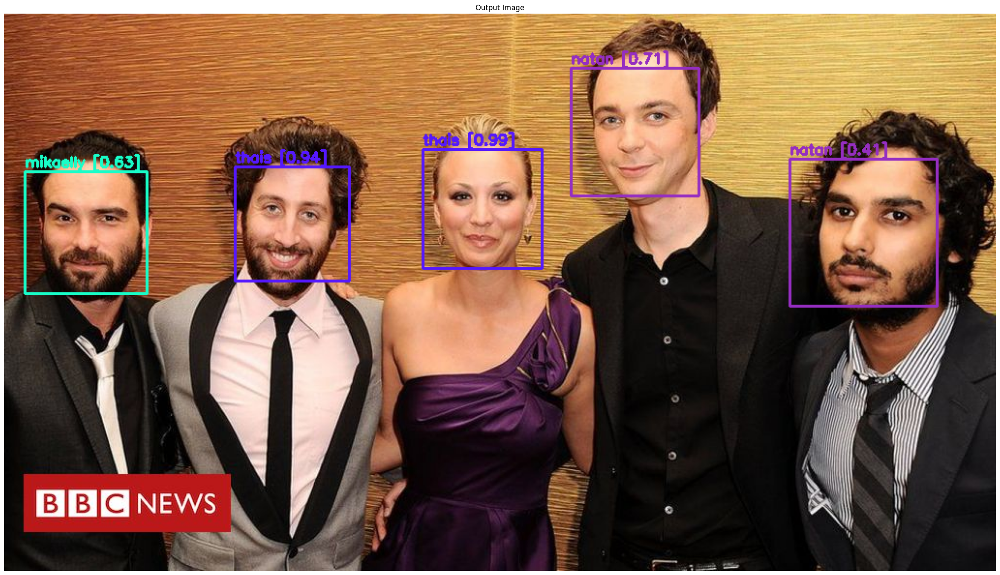

Number of faces detected: 5
1/1 [==============================] - 0s 25ms/step


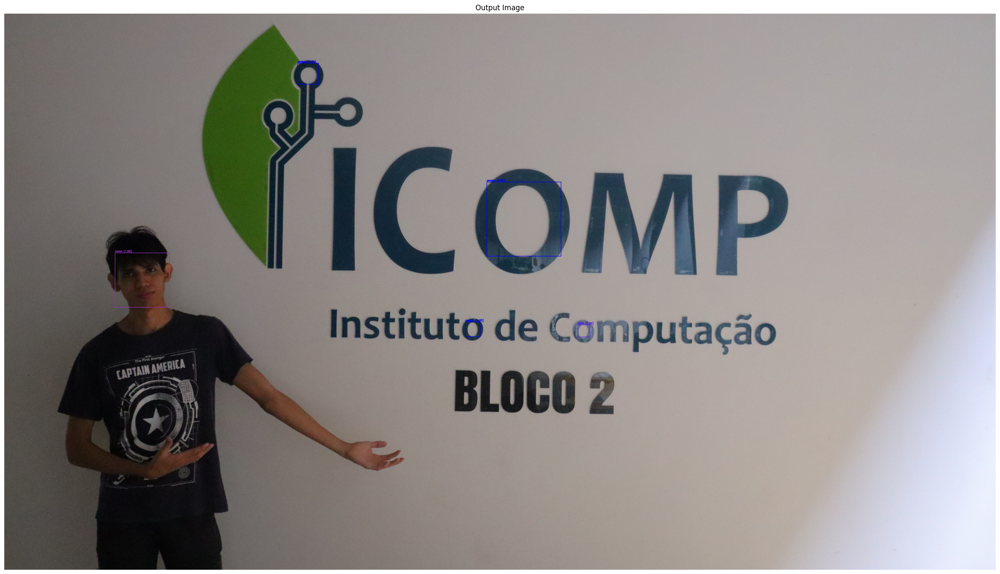

Number of faces detected: 5
1/1 [==============================] - 0s 29ms/step


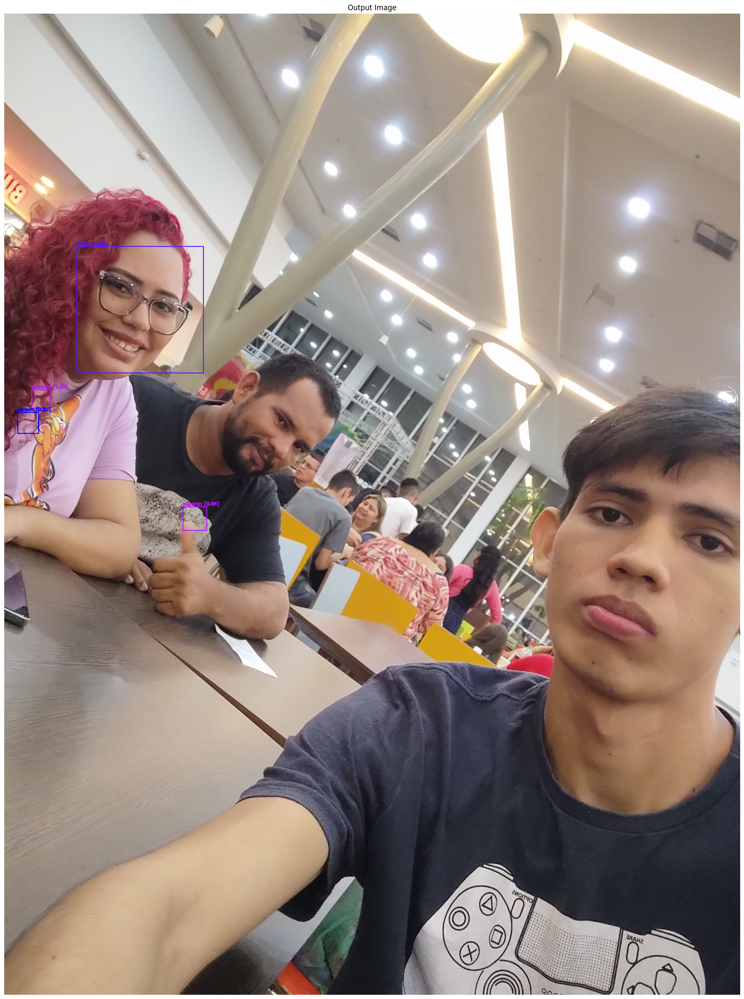

Number of faces detected: 4
1/1 [==============================] - 0s 25ms/step


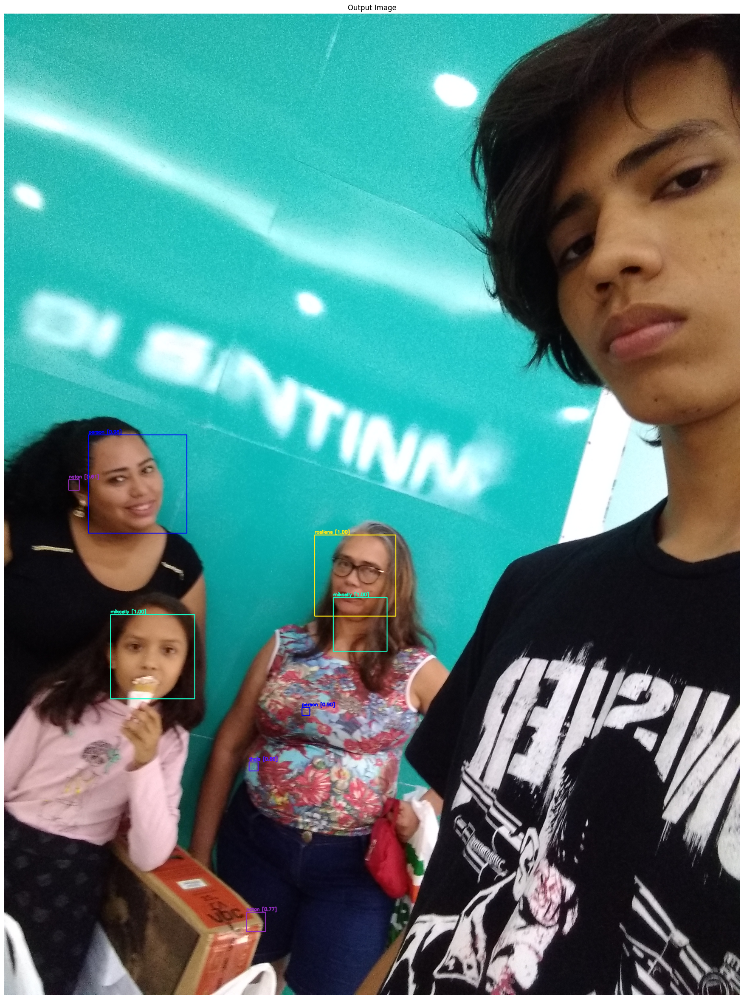

Number of faces detected: 8
1/1 [==============================] - 0s 33ms/step


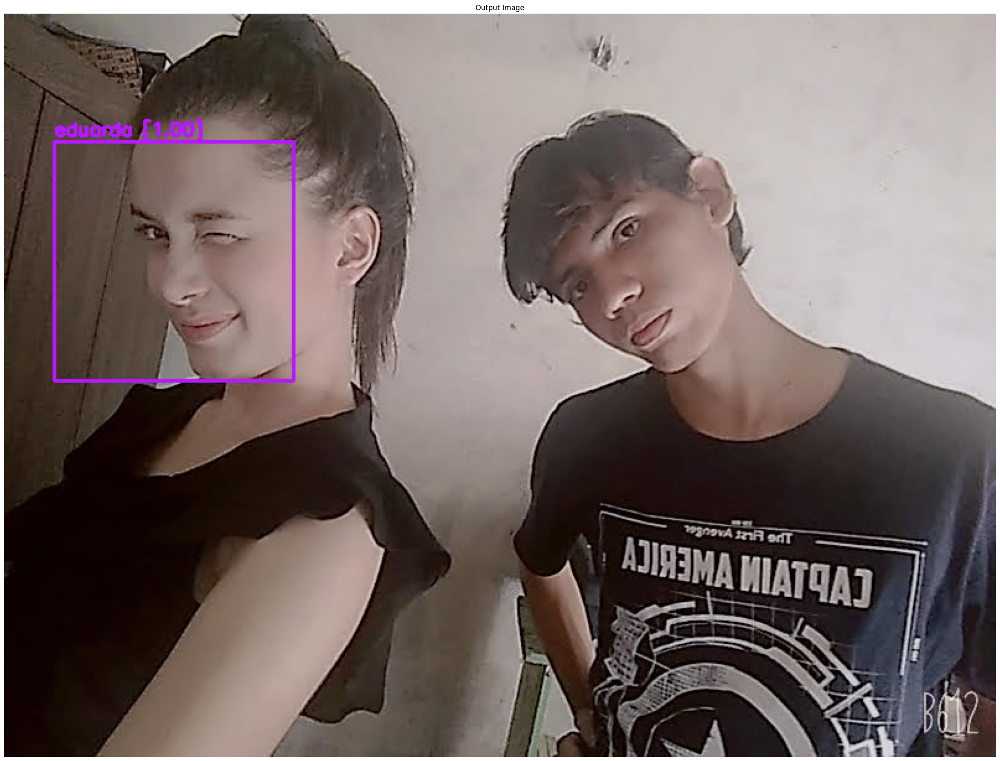

Number of faces detected: 1


In [6]:
uploaded = files.upload()

for fn in uploaded.keys():
  num_faces = crop_predict(fn, face_cascade, loaded_model, labels, colors)
  print(f"Number of faces detected: {num_faces}")